In [1]:
!pip install -q transformers
!pip install -q easyocr
!pip install PyMuPDF tqdm
!pip install pdf2image pandas torch

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 44.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 307.2/307.2 kB 22.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 912.2/912.2 kB 59.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 286.8/286.8 kB 26.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 19.6/19.6 MB 34.4 MB/s eta 0:00:00


In [3]:
!apt-get install -y poppler-utils

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following NEW packages will be installed:
  poppler-utils
0 upgraded, 1 newly installed, 0 to remove and 49 not upgraded.
Need to get 186 kB of archives.
After this operation, 696 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy-updates/main amd64 poppler-utils amd64 22.02.0-2ubuntu0.5 [186 kB]
Fetched 186 kB in 0s (437 kB/s)
Selecting previously unselected package poppler-utils.
(Reading database ... 123622 files and directories currently installed.)
Preparing to unpack .../poppler-utils_22.02.0-2ubuntu0.5_amd64.deb ...
Unpacking poppler-utils (22.02.0-2ubuntu0.5) ...
Setting up poppler-utils (22.02.0-2ubuntu0.5) ...
Processing triggers for man-db (2.10.2-1) ...


Processing page 1/19


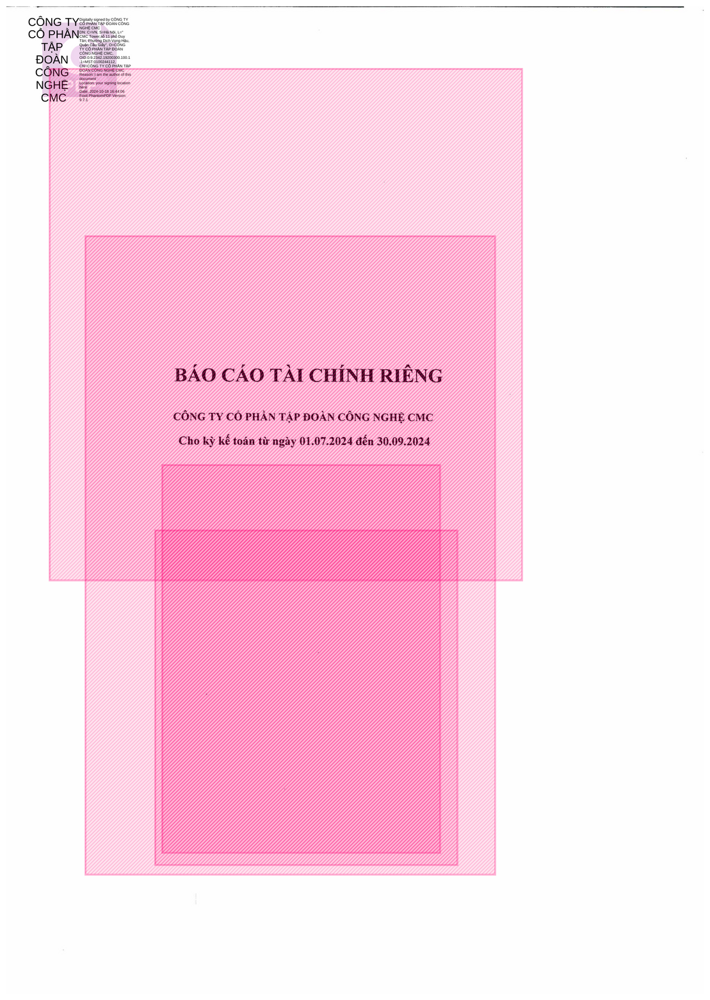

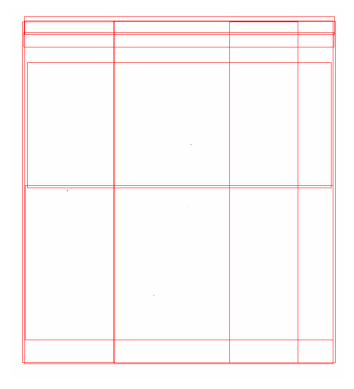

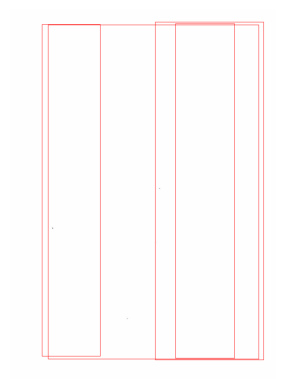

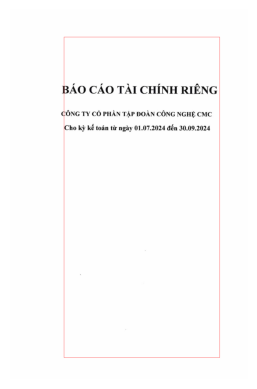

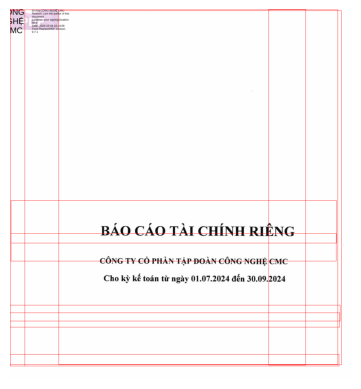

Processing page 2/19


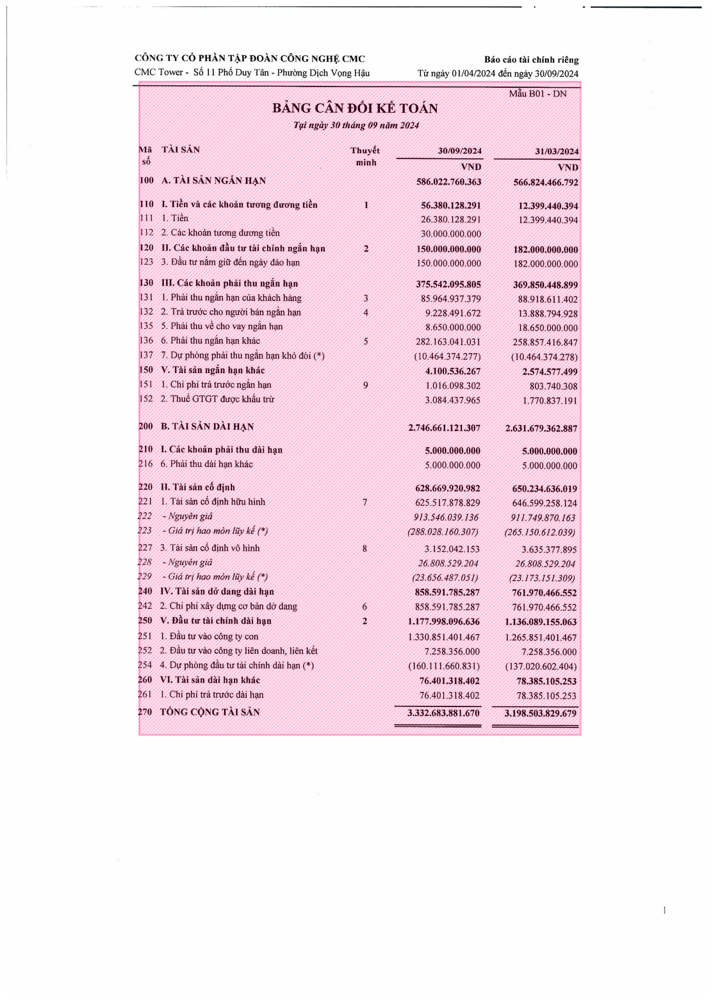

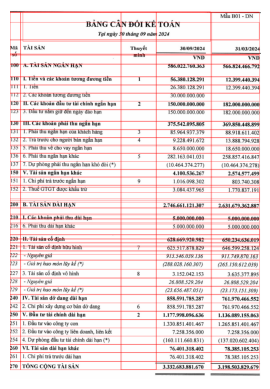

Processing page 3/19


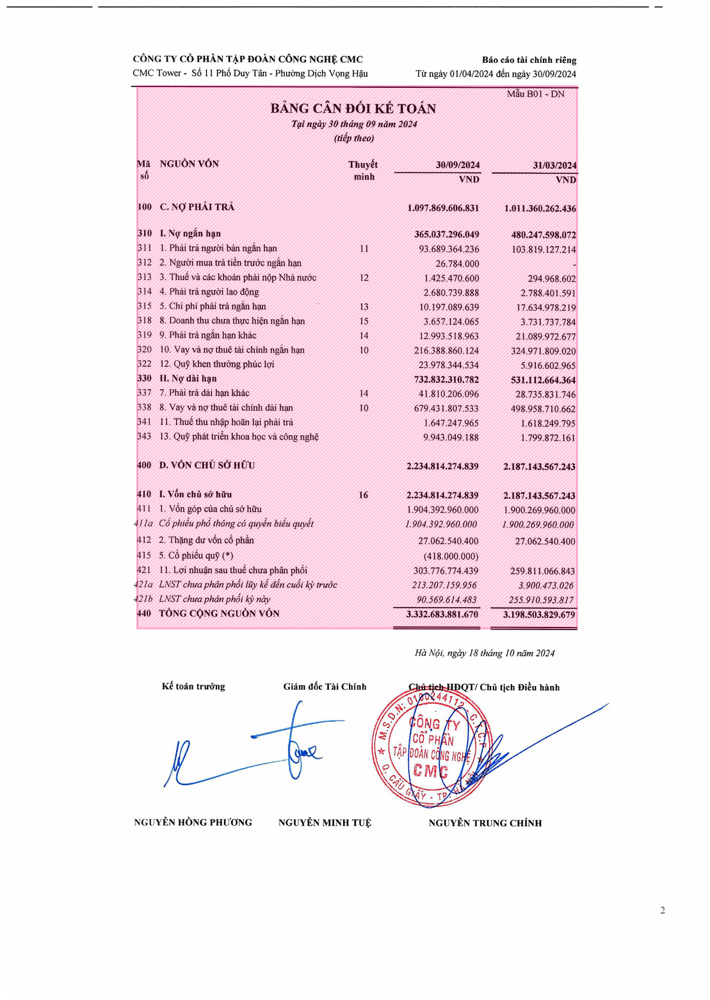

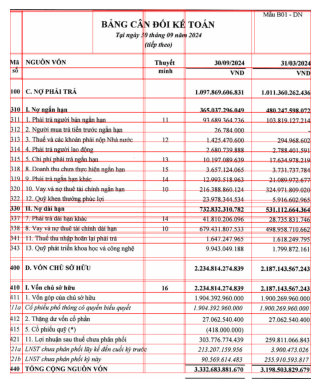

Processing page 4/19


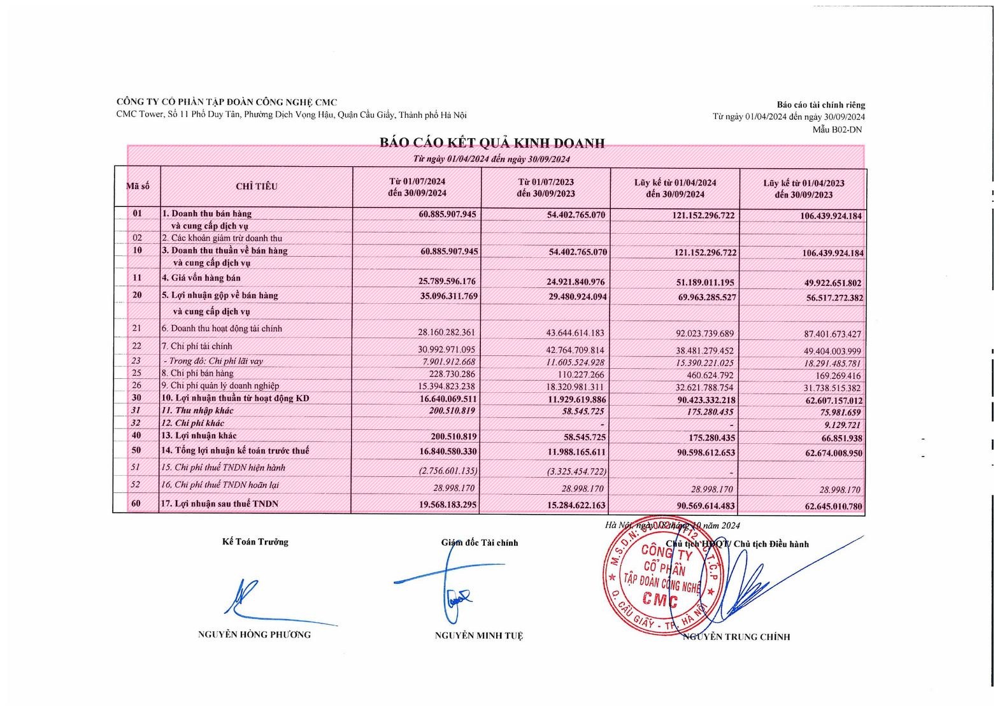

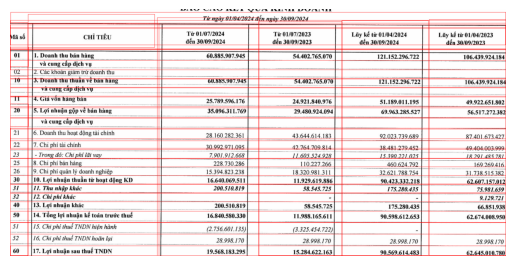

Processing page 5/19


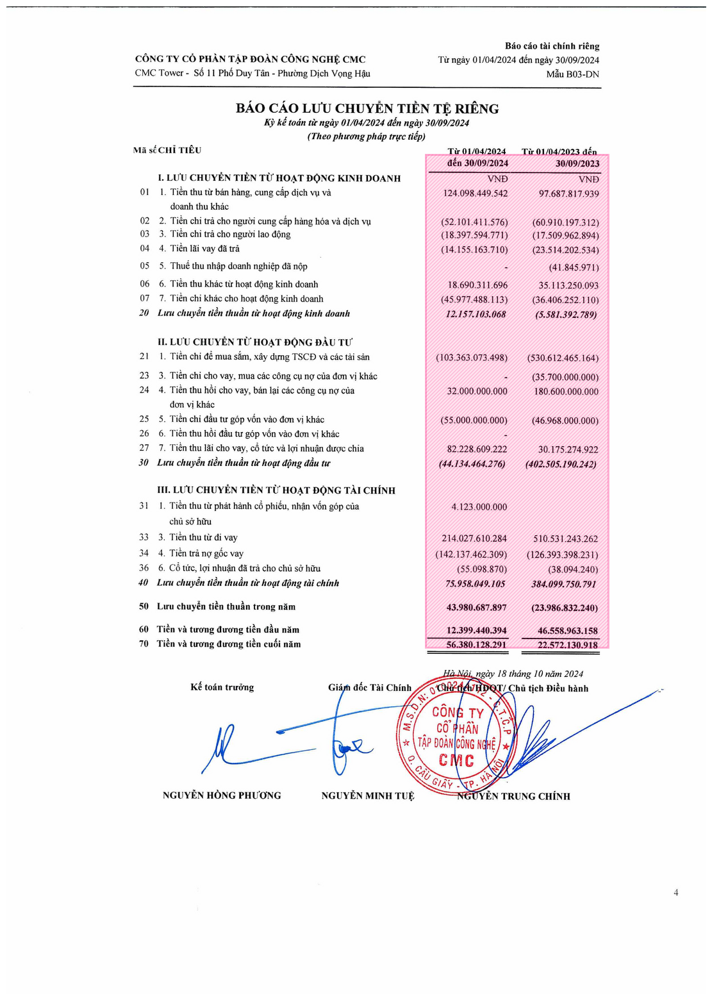

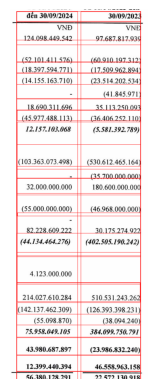

Processing page 6/19


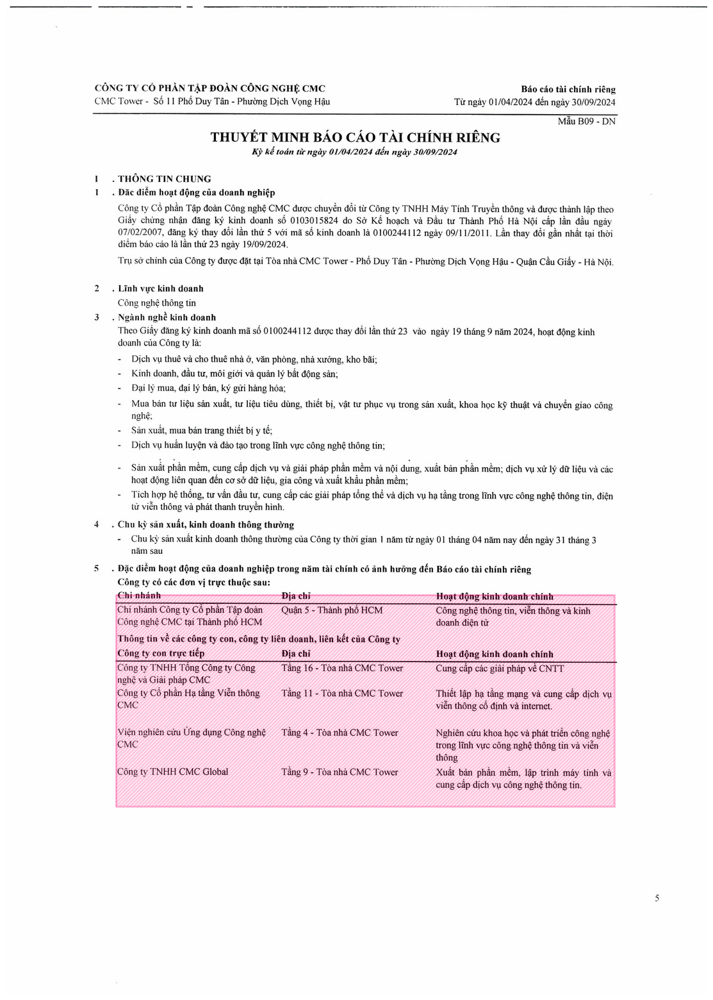

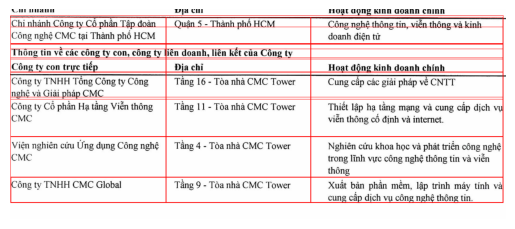

Processing page 7/19


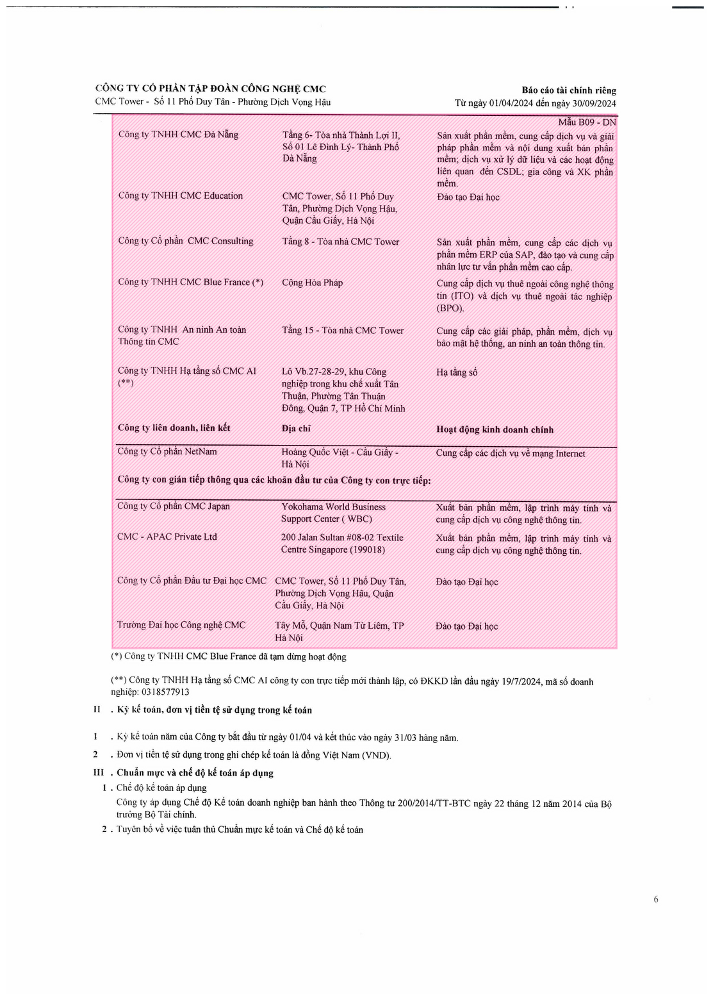

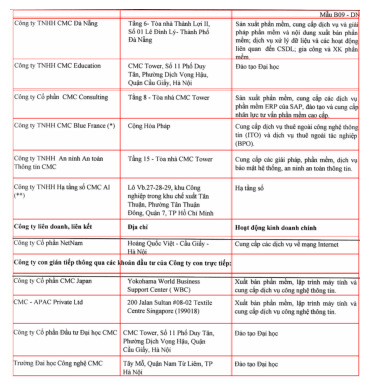

Processing page 8/19


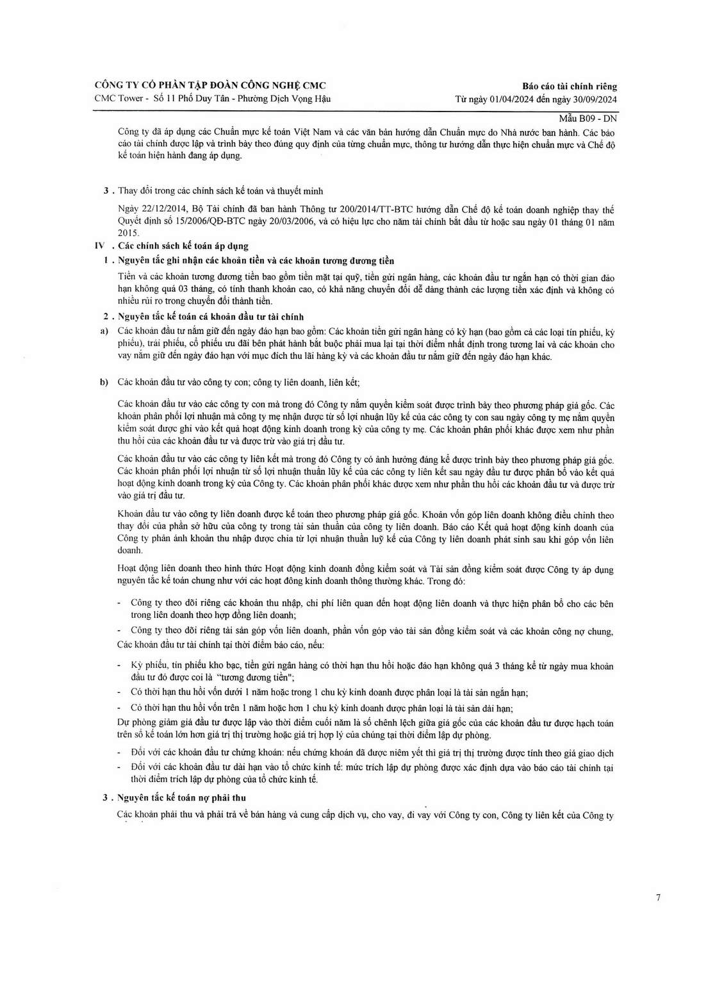

Processing page 9/19


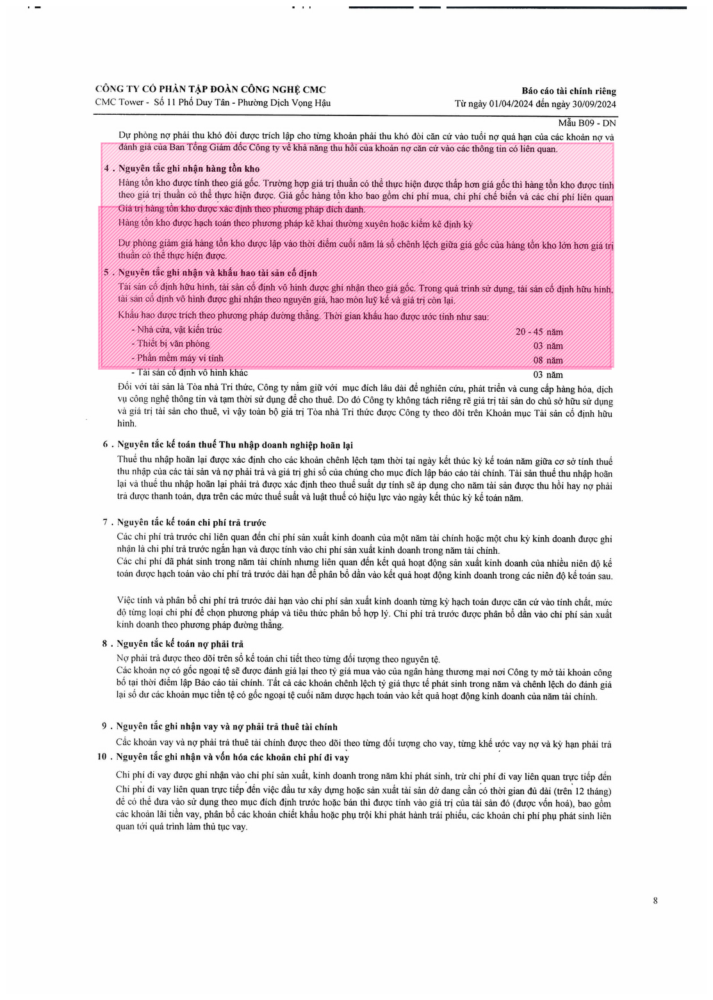

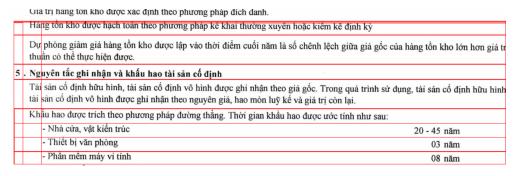

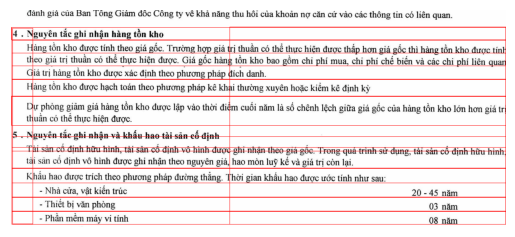

Processing page 10/19


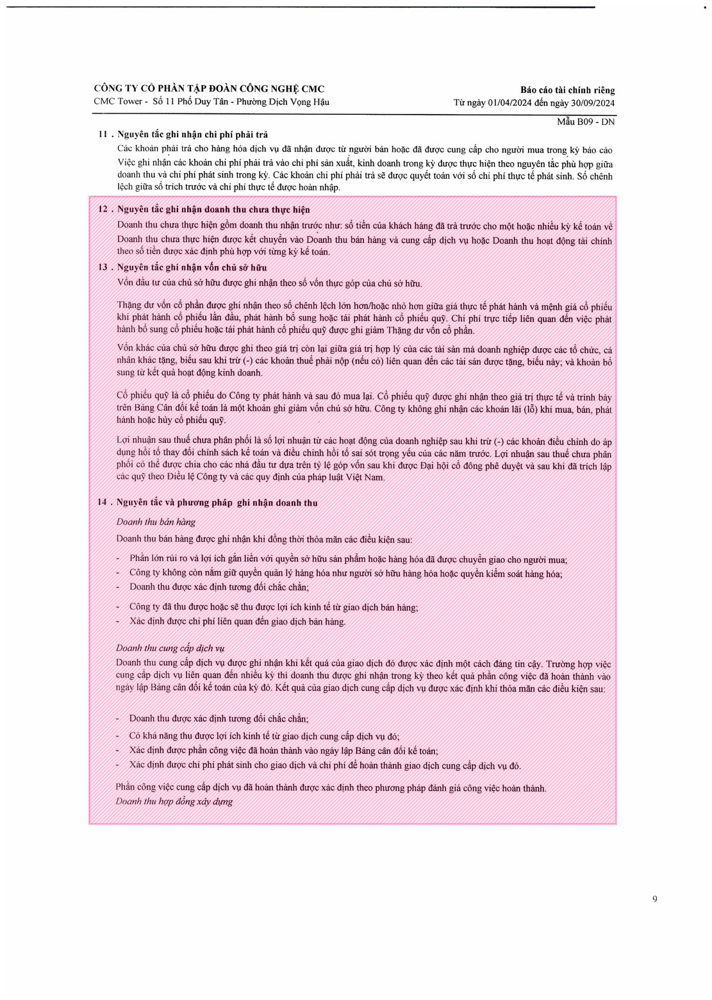

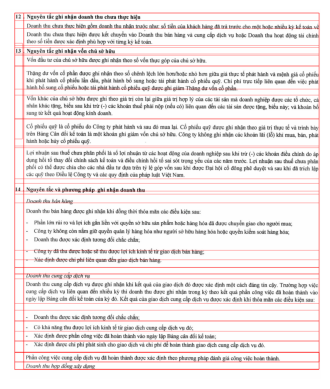

Processing page 11/19


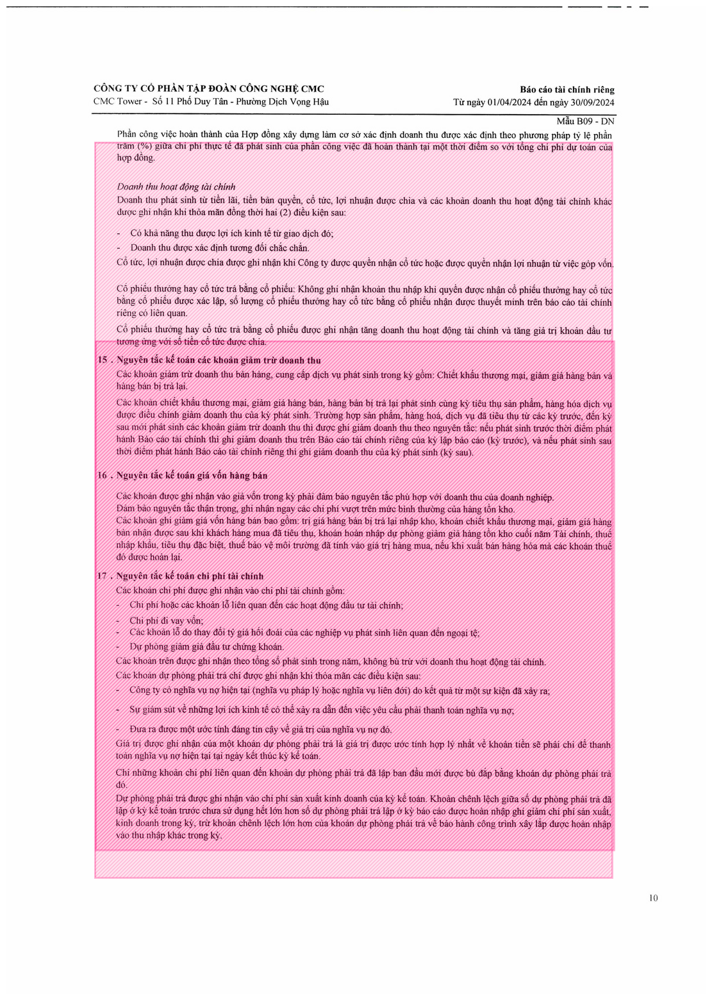

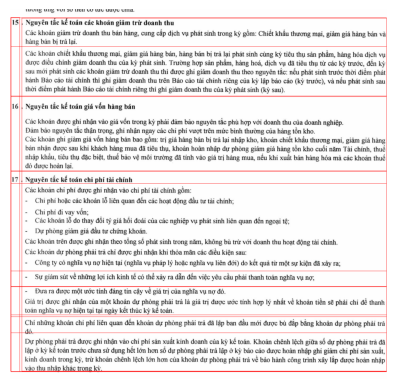

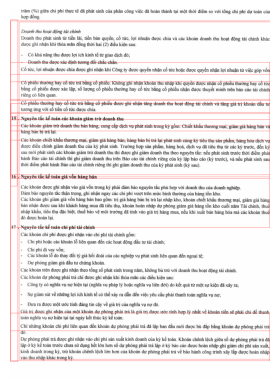

Processing page 12/19


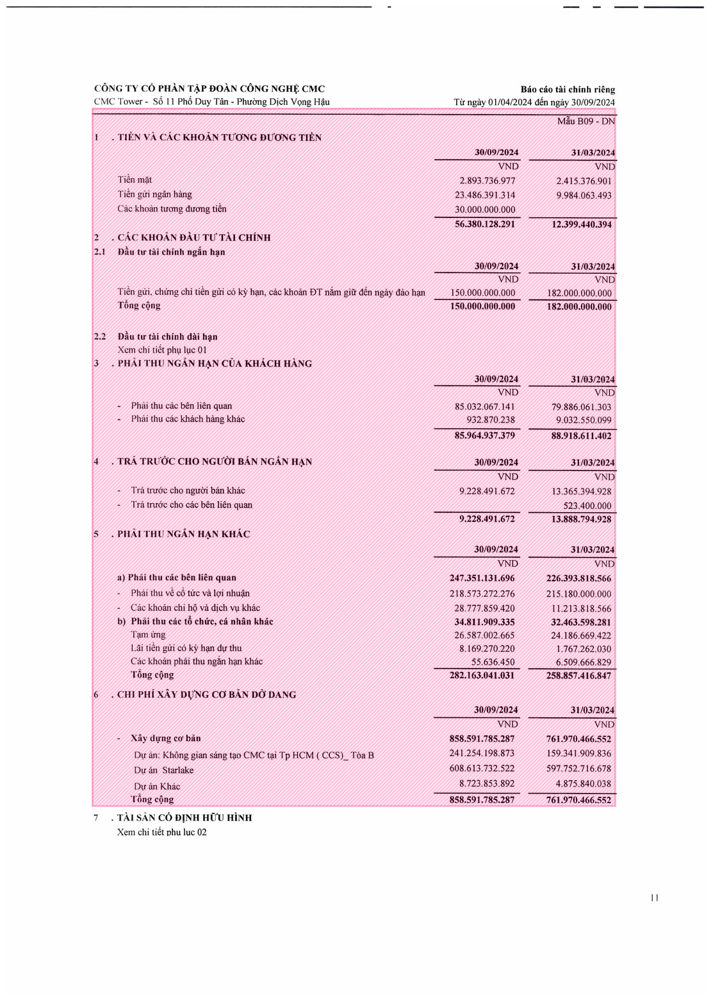

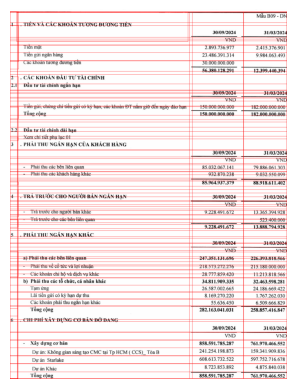

Processing page 13/19


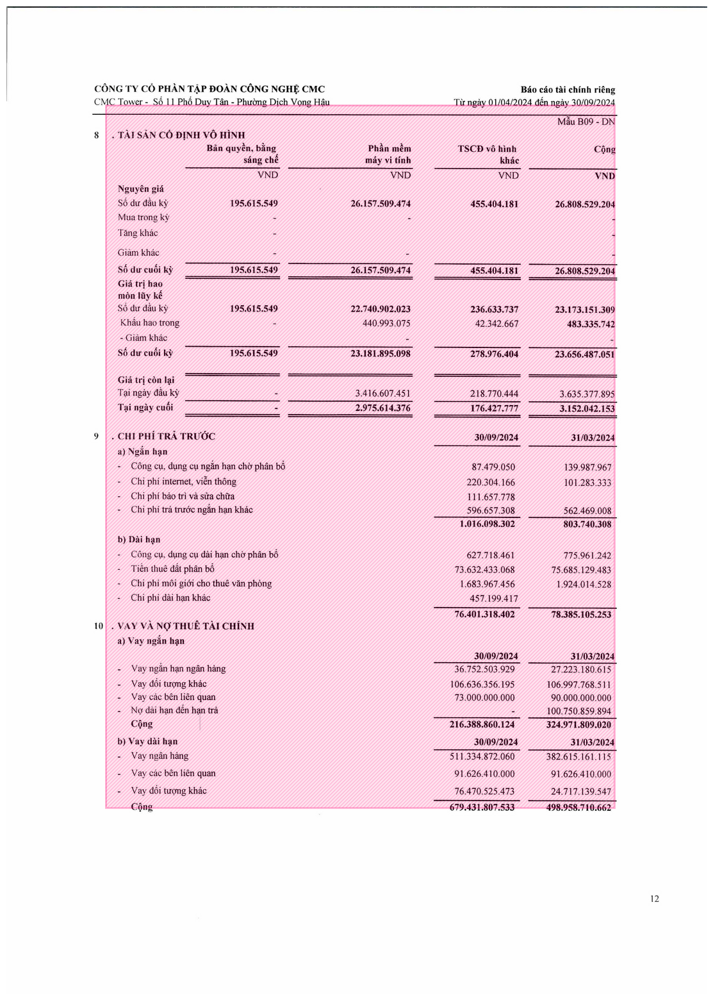

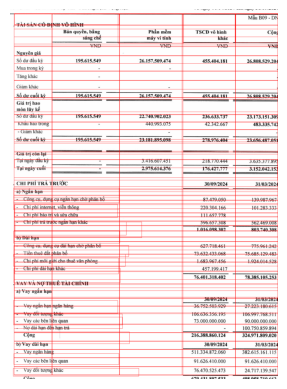

Processing page 14/19


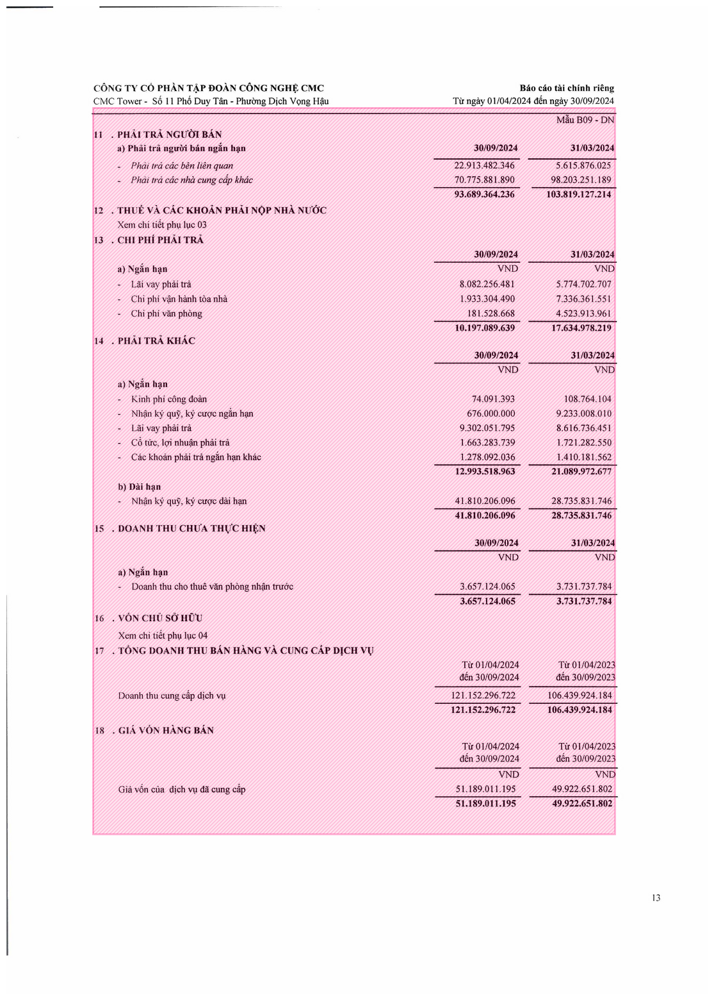

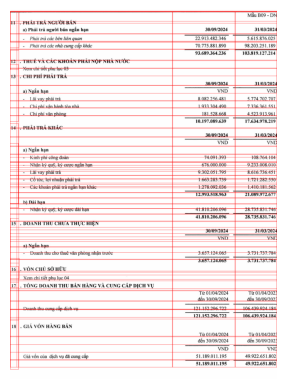

Processing page 15/19


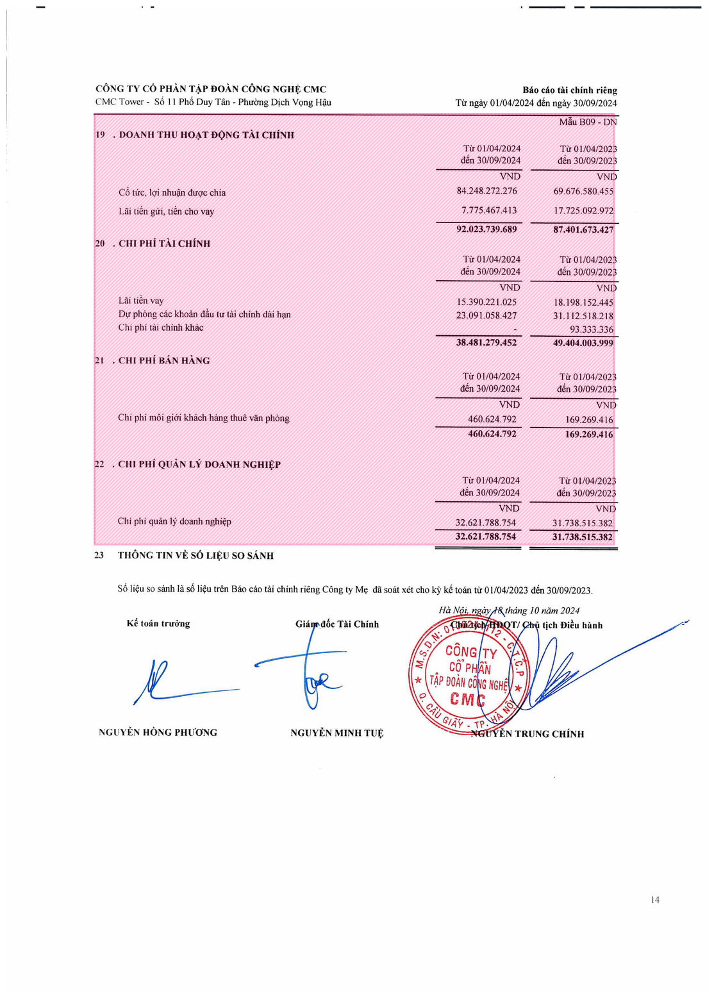

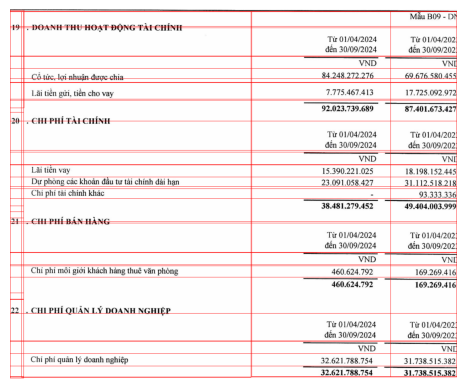

Processing page 16/19


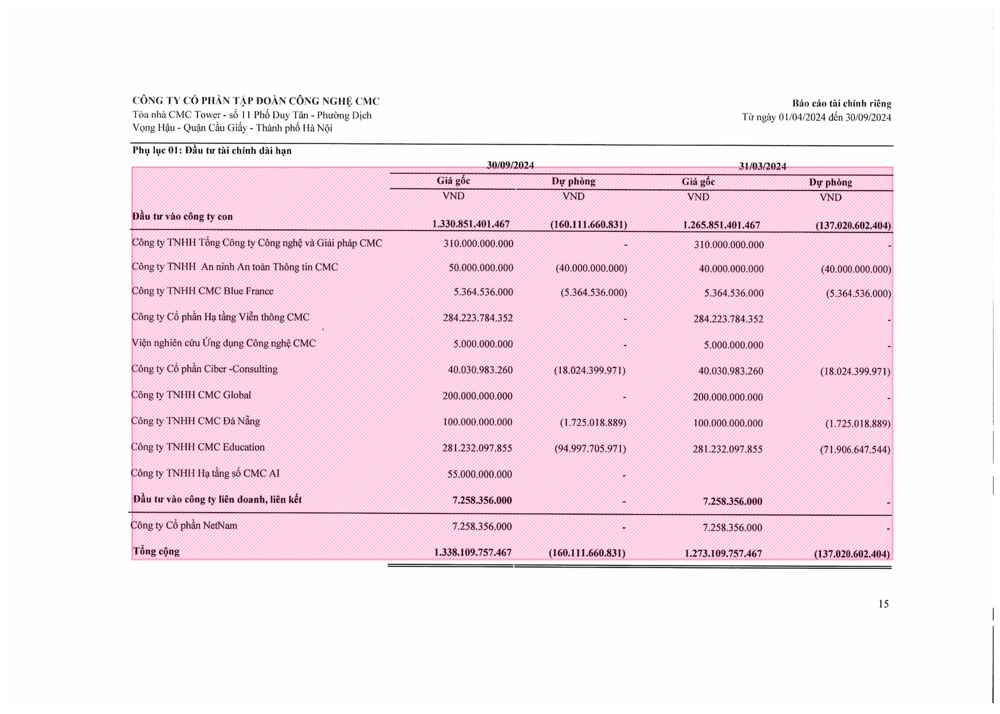

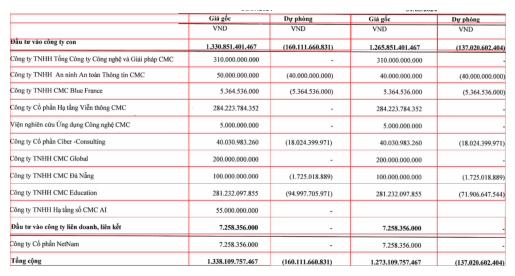

Processing page 17/19


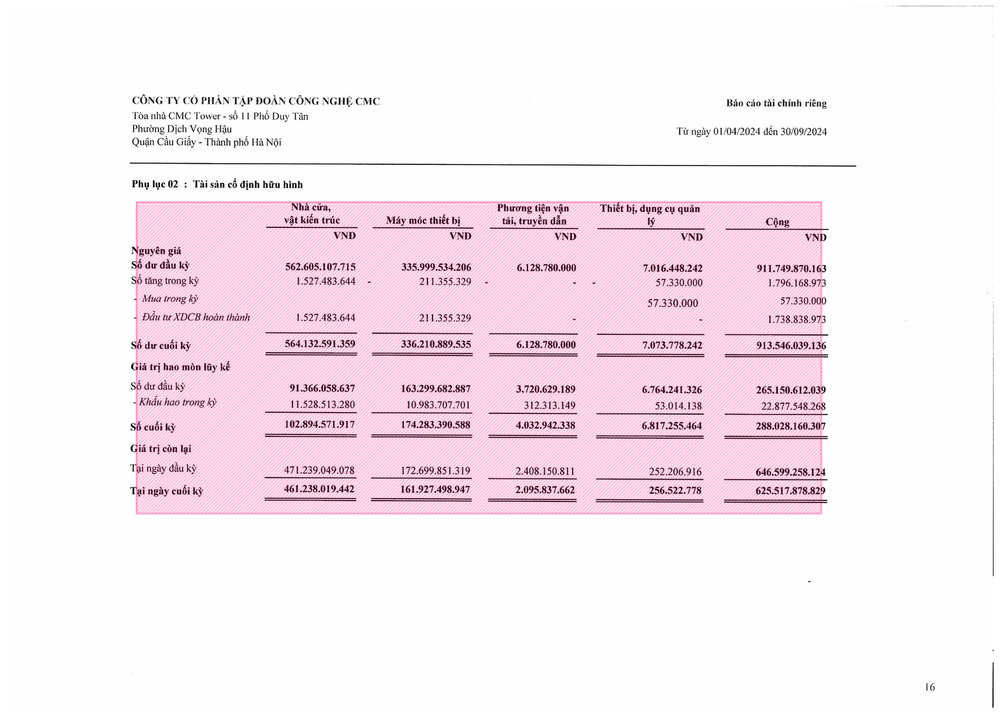

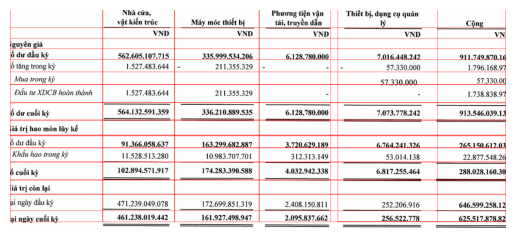

Processing page 18/19


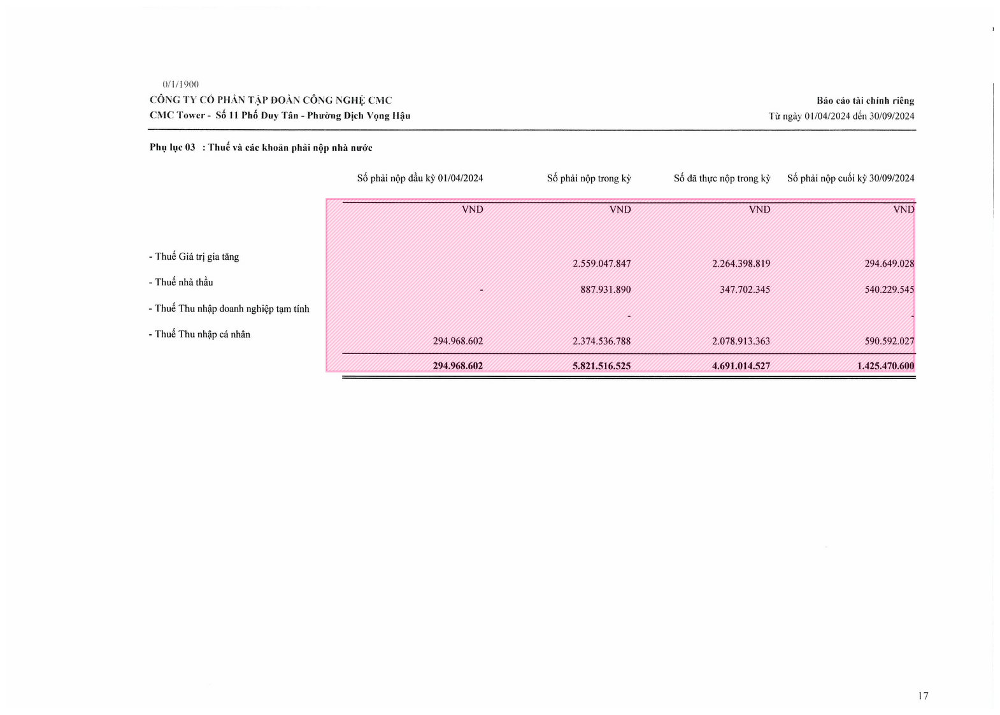

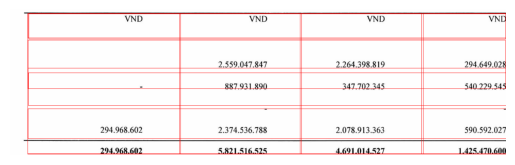

Processing page 19/19


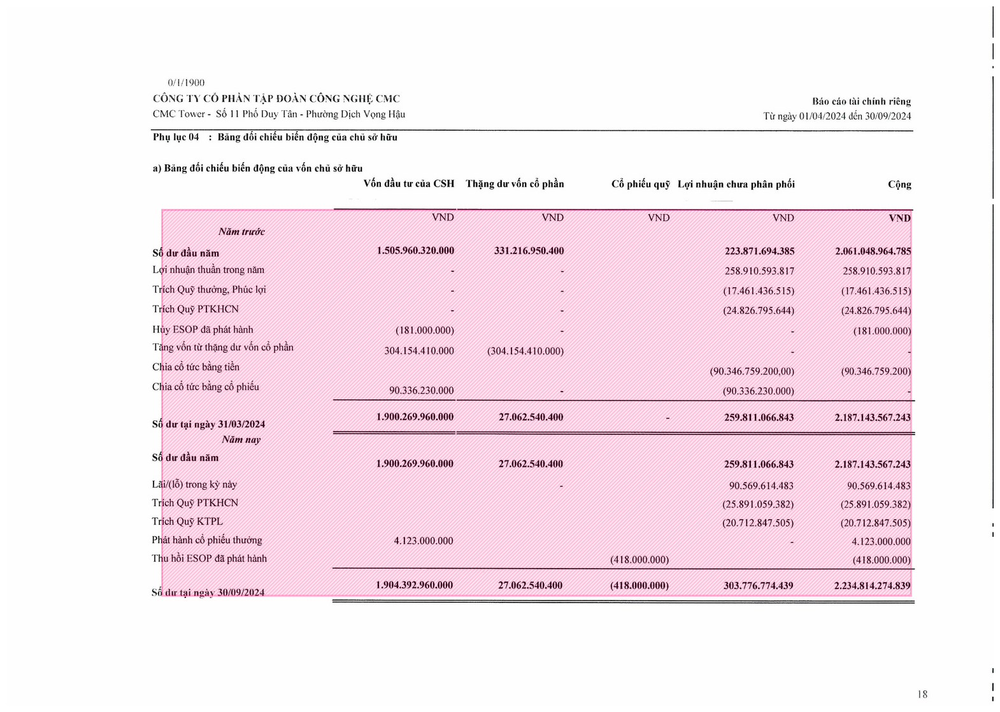

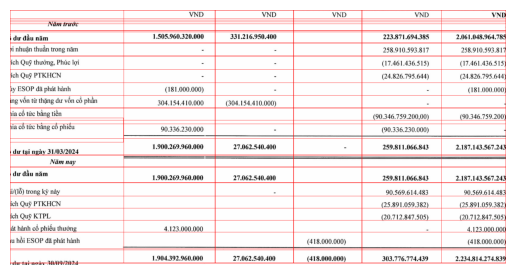

In [7]:
import torch
from transformers import AutoModelForObjectDetection, TableTransformerForObjectDetection
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from torchvision import transforms
import numpy as np
import pandas as pd
import easyocr
from tqdm.auto import tqdm
import cv2
import os
from pdf2image import convert_from_path

# Load the model for object detection
def load_detection_model():
    model = AutoModelForObjectDetection.from_pretrained("microsoft/table-transformer-detection", revision="no_timm")
    device = "cuda" if torch.cuda.is_available() else "cpu"
    model.to(device)
    return model, device

# Load the model for structure recognition
def load_structure_model(device):
    structure_model = TableTransformerForObjectDetection.from_pretrained("microsoft/table-structure-recognition-v1.1-all")
    structure_model.to(device)
    return structure_model
# Load and preprocess the image
def load_image(file_path):
    image = Image.open(file_path).convert("RGB")
    return image

# Resize the image
class MaxResize(object):
    def __init__(self, max_size=800):
        self.max_size = max_size

    def __call__(self, image):
        width, height = image.size
        current_max_size = max(width, height)
        scale = self.max_size / current_max_size
        resized_image = image.resize((int(round(scale*width)), int(round(scale*height))))
        return resized_image

def preprocess_image(image, max_size=800):
    detection_transform = transforms.Compose([
        MaxResize(max_size),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])
    pixel_values = detection_transform(image).unsqueeze(0)
    return pixel_values

# Run detection on the image
def detect_objects(model, pixel_values, device):
    pixel_values = pixel_values.to(device)
    with torch.no_grad():
        outputs = model(pixel_values)
    return outputs

# Post-process the outputs
def box_cxcywh_to_xyxy(x):
    x_c, y_c, w, h = x.unbind(-1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h), (x_c + 0.5 * w), (y_c + 0.5 * h)]
    return torch.stack(b, dim=1)

def rescale_bboxes(out_bbox, size):
    img_w, img_h = size
    b = box_cxcywh_to_xyxy(out_bbox)
    b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32)
    return b

def outputs_to_objects(outputs, img_size, id2label):
    m = outputs.logits.softmax(-1).max(-1)
    pred_labels = list(m.indices.detach().cpu().numpy())[0]
    pred_scores = list(m.values.detach().cpu().numpy())[0]
    pred_bboxes = outputs['pred_boxes'].detach().cpu()[0]
    pred_bboxes = [elem.tolist() for elem in rescale_bboxes(pred_bboxes, img_size)]

    objects = []
    for label, score, bbox in zip(pred_labels, pred_scores, pred_bboxes):
        class_label = id2label[int(label)]
        if not class_label == 'no object':
            objects.append({'label': class_label, 'score': float(score), 'bbox': [float(elem) for elem in bbox]})

    return objects
# Visualize the detected tables
def visualize_detected_tables(img, det_tables):
    plt.imshow(img, interpolation="lanczos")
    fig = plt.gcf()
    fig.set_size_inches(20, 20)
    ax = plt.gca()

    for det_table in det_tables:
        bbox = det_table['bbox']
        facecolor = (1, 0, 0.45) if det_table['label'] == 'table' else (0.95, 0.6, 0.1)
        edgecolor = facecolor
        alpha = 0.3
        linewidth = 2
        hatch='//////'

        rect = patches.Rectangle(bbox[:2], bbox[2]-bbox[0], bbox[3]-bbox[1], linewidth=linewidth,
                                 edgecolor='none', facecolor=facecolor, alpha=0.1)
        ax.add_patch(rect)
        rect = patches.Rectangle(bbox[:2], bbox[2]-bbox[0], bbox[3]-bbox[1], linewidth=linewidth,
                                 edgecolor=edgecolor, facecolor='none', linestyle='-', alpha=alpha)
        ax.add_patch(rect)
        rect = patches.Rectangle(bbox[:2], bbox[2]-bbox[0], bbox[3]-bbox[1], linewidth=0,
                                 edgecolor=edgecolor, facecolor='none', linestyle='-', hatch=hatch, alpha=0.2)
        ax.add_patch(rect)

    plt.xticks([], [])
    plt.yticks([], [])
    plt.axis('off')
    plt.show()

# Main function to process the PDF file
def process_pdf(pdf_path, output_folder):
    # Convert PDF to images
    images = convert_from_path(pdf_path)

    model, device = load_detection_model()
    structure_model = load_structure_model(device)

    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    for page_num, image in enumerate(images):
        print(f"Processing page {page_num + 1}/{len(images)}")

        # Detect tables in the image
        pixel_values = preprocess_image(image)
        outputs = detect_objects(model, pixel_values, device)

        id2label = model.config.id2label
        id2label[len(model.config.id2label)] = "no object"
        objects = outputs_to_objects(outputs, image.size, id2label)

        # Visualize detected tables
        visualize_detected_tables(image, objects)

        # Create a mask for the detected table bounding boxes
        detected_bboxes = [obj['bbox'] for obj in objects if obj['label'] in ['table', 'table rotated']]

        # Create a new image with the table areas removed
        image_without_tables = remove_table_areas(image, detected_bboxes)

        # Perform OCR on the remaining area of the image
        remaining_text = apply_ocr_remaining_area(image_without_tables)
        save_remaining_text_to_txt(remaining_text, output_folder, page_num)

        # Process each cropped table and save data as CSV
        table_data_list = []
        for idx, bbox in enumerate(detected_bboxes):
            x_min, y_min, x_max, y_max = bbox
            cropped_table = image.crop((x_min, y_min, x_max, y_max))
            table_data = process_cropped_table(cropped_table, structure_model, device, page_num, idx, output_folder)
            table_data_list.append(table_data)

# Remove table areas from the image
def remove_table_areas(image, detected_bboxes):
    img_arr = np.array(image)
    for bbox in detected_bboxes:
        x_min, y_min, x_max, y_max = map(int, bbox)
        img_arr[y_min:y_max, x_min:x_max] = 255  # Set the area to white
    return Image.fromarray(img_arr)

# Function to process each cropped table and save to CSV
def process_cropped_table(cropped_table, structure_model, device, page_num, table_index, output_folder):
    structure_transform = transforms.Compose([
        MaxResize(1000),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])

    pixel_values = structure_transform(cropped_table).unsqueeze(0)
    pixel_values = pixel_values.to(device)

    # Forward pass
    with torch.no_grad():
        outputs = structure_model(pixel_values)

    # Update id2label to include "no object"
    structure_id2label = structure_model.config.id2label
    structure_id2label[len(structure_id2label)] = "no object"

    cells = outputs_to_objects(outputs, cropped_table.size, structure_id2label)

    # Visualize the detected cells in the cropped table
    visualize_cropped_table(cropped_table, cells)

    # Apply OCR to the detected cells
    cell_coordinates = get_cell_coordinates_by_row(cells)
    data = apply_ocr(cell_coordinates, cropped_table)

    # Save extracted data to CSV
    csv_filename = os.path.join(output_folder, f'page_{page_num + 1}_table_{table_index + 1}.csv')
    save_to_csv(data, csv_filename)

    return data
# Visualize the cropped table with detected cells
def visualize_cropped_table(cropped_table, cells):
    cropped_table_visualized = cropped_table.copy()
    draw = ImageDraw.Draw(cropped_table_visualized)

    for cell in cells:
        draw.rectangle(cell["bbox"], outline="red")

    plt.imshow(cropped_table_visualized)
    plt.axis('off')
    plt.show()
def get_cell_coordinates_by_row(table_data):
    rows = [entry for entry in table_data if entry['label'] == 'table row']
    columns = [entry for entry in table_data if entry['label'] == 'table column']

    rows.sort(key=lambda x: x['bbox'][1])
    columns.sort(key=lambda x: x['bbox'][0])

    def find_cell_coordinates(row, column):
        cell_bbox = [column['bbox'][0], row['bbox'][1], column['bbox'][2], row['bbox'][3]]
        return cell_bbox

    cell_coordinates = []
    for row in rows:
        row_cells = []
        for column in columns:
            cell_bbox = find_cell_coordinates(row, column)
            row_cells.append({'bbox': cell_bbox})
        cell_coordinates.append(row_cells)

    return cell_coordinates
def apply_ocr(cell_coordinates, cropped_table):
    reader = easyocr.Reader(['vi'])
    extracted_data = []

    for row in cell_coordinates:
        row_data = []
        for cell in row:
            x_min, y_min, x_max, y_max = cell['bbox']
            cell_image = cropped_table.crop((x_min, y_min, x_max, y_max))
            text = reader.readtext(np.array(cell_image), detail=0)
            row_data.append(' '.join(text))
        extracted_data.append(row_data)

    return extracted_data
# OCR for remaining text area
def apply_ocr_remaining_area(remaining_area_image):
    reader = easyocr.Reader(['vi'])
    text = reader.readtext(np.array(remaining_area_image), detail=0)
    return ' '.join(text)

# Save text to TXT
def save_remaining_text_to_txt(text, output_folder, page_num):
    txt_filename = os.path.join(output_folder, f'page_{page_num + 1}_remaining_text.txt')
    with open(txt_filename, "w", encoding="utf-8") as f:
        f.write(text)

# Save data to CSV
def save_to_csv(data, csv_filename):
    df = pd.DataFrame(data)
    df.to_csv(csv_filename, index=False)

# Example usage
pdf_path = "file.pdf"  # Path to your PDF file
output_folder = "/content/output"  # Output folder for CSV and TXT files
process_pdf(pdf_path, output_folder)